# Particle simulation vs Langevin model

In [1]:
using ProgressMeter
using Revise
using JLD2

In [2]:
include("../src/bmparticles.jl")
include("../src/bmtheory.jl")
using .BParts
using .Theorist
using DifferentialEquations, Distributions

## Growing population

### Parameters

In [3]:
using Plots
# plotly()
gr()
# plotlyjs()
# pyplot()

Plots.GRBackend()

In [4]:
using LaTeXStrings

In [5]:
function extendParams!(arenaParams::Dict)
    bounds = arenaParams["bounds"]
    arenaParams["volume"] = abs(bounds[1][2]-bounds[1][1])*abs(bounds[2][2]-bounds[2][1])
    arenaParams["bperiod"] = [abs(bounds[1][2]-bounds[1][1]), abs(bounds[2][2]-bounds[2][1])]
    arenaParams["E"] = arenaParams["speed"]^2/2
end

extendParams! (generic function with 1 method)

In [6]:
arenaParams = 
    Dict(
        "n0"=>100,
        "evolveTime"=>5500,
        "bounds"=>((0.,10.),(0.,10.)), 
        "radius"=>0.08, 
        "speed"=>0.02,
        "timeStep"=> 0.1
    )

growthParams =
    Dict(
        "ρ"=> 0.001,
        "k"=> 1000,
        "randGrowth"=> false,
        "waitTime"=> 500
    )

extendParams!(arenaParams)

display(arenaParams)
display(growthParams)

function fillDensity(arenaParams, growthParams)  
    xperiod = abs(arenaParams["bounds"][1][2] - arenaParams["bounds"][1][1])
    yperiod = abs(arenaParams["bounds"][2][2] - arenaParams["bounds"][2][1])
    n0 = arenaParams["n0"]
    nT = growthParams["k"]
    r = arenaParams["radius"]
    V = xperiod*yperiod
    fillDens0 = n0*π*r^2 / V
    fillDensT = nT*π*r^2 / V
    return fillDens0, fillDensT
end

volumeDens(n, r, V) = n*π*r^2/V

timeSteps = arenaParams["timeStep"]:arenaParams["timeStep"]:arenaParams["evolveTime"]

println("t0 density: ", fillDensity(arenaParams, growthParams)[1])
println("t0 density: ", fillDensity(arenaParams, growthParams)[2])

Dict{String,Any} with 9 entries:
  "volume"     => 100.0
  "evolveTime" => 5500
  "speed"      => 0.02
  "radius"     => 0.08
  "timeStep"   => 0.1
  "E"          => 0.0002
  "bounds"     => ((0.0, 10.0), (0.0, 10.0))
  "bperiod"    => [10.0, 10.0]
  "n0"         => 100

Dict{String,Real} with 4 entries:
  "waitTime"   => 500
  "k"          => 1000
  "ρ"          => 0.001
  "randGrowth" => false

t0 density: 0.02010619298297468
t0 density: 0.20106192982974677


### Logistic Growth

The number of cells in the system increases according to the logistic growth function:
\begin{equation}
n(t) = \frac{k}{ 1 + \frac{k-n_0}{n_0}e^{-\rho t}}
\end{equation}


### Mean Free Path and Friction

In [7]:
nCells_t = Theorist.logisticGrowth.(0:(arenaParams["evolveTime"]-growthParams["waitTime"]-1), 
            growthParams["ρ"], growthParams["k"], arenaParams["n0"]);

mfpTheory_t = (x -> Theorist.meanFreePath(x, 4*arenaParams["radius"])).(nCells_t);
frictionTheory_t = ( l -> Theorist.friction(l, arenaParams["E"]) ).(mfpTheory_t);

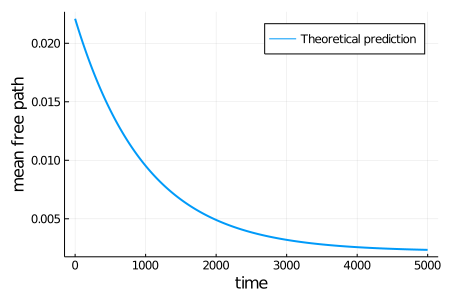

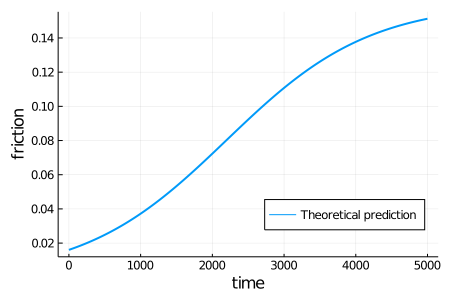

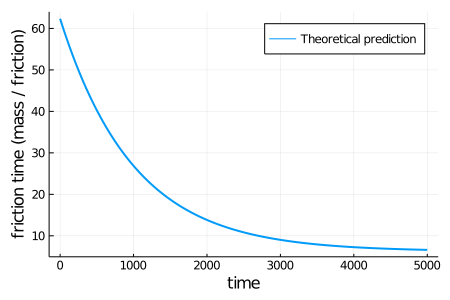

In [8]:
f2 = plot(0:(arenaParams["evolveTime"]-growthParams["waitTime"]-1), mfpTheory_t,
        label="Theoretical prediction",
        linewidth=2,
        legend=:topright,
        size=(450,300))
xlabel!("time")
ylabel!("mean free path")
display(f2)

savefig(f2, "../Figures/rho"*string(growthParams["ρ"])*"mfp_time.pdf")

f3 = plot(0:(arenaParams["evolveTime"]-growthParams["waitTime"]-1), 
            arenaParams["speed"]*frictionTheory_t,
        label="Theoretical prediction",
        linewidth=2,
        legend=:bottomright,
        size=(450,300))
xlabel!("time")
ylabel!("friction")
display(f3)

savefig(f3, "../Figures/rho"*string(growthParams["ρ"])*"friction_time.pdf")

f4 = plot(0:(arenaParams["evolveTime"]-growthParams["waitTime"]-1),
            1 ./ (arenaParams["speed"]*frictionTheory_t),
        label="Theoretical prediction",
        linewidth=2,
#         legend=:bottomright,
        size=(450,300))
xlabel!("time")
ylabel!("friction time (mass / friction)")
display(f4)

savefig(f4, "../Figures/rho"*string(growthParams["ρ"])*"frictionTime_time.pdf")

Run Langevin simulations:

In [9]:
@time langevinEnsemble = Theorist.runLangevinSims(5000, arenaParams, growthParams);

Energy: 0.0002
242.250862 seconds (6.53 G allocations: 108.756 GiB, 18.93% gc time)


Run a particle simulation:

In [10]:
@time arena, pos_t_dim_id, vel_t_dim_id, cells_T_ID, times_t = 
        BParts.randArenaEvolve(
            arenaParams["n0"], 
            arenaParams["evolveTime"],
            arenaParams["timeStep"],
            arenaParams,
            growthParams,
            verbose=true);

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999


Progress:  45%|██████████████████▍                      |  ETA: 0:00:31

anomalous collision time 1.2374093474443928 found in time step0.1
anomalous collision time 1.3514191747537752 found in time step0.1
anomalous collision time 20.74533541406862 found in time step0.1
anomalous collision time 21.527066334740873 found in time step0.1


Progress: 100%|█████████████████████████████████████████|  ETA: 0:00:00

224.913797 seconds (385.98 M allocations: 16.408 GiB, 5.49% gc time)


In [11]:
msdPart0_t = BParts.meanSquaredDisplacement(pos_t_dim_id, msdTimes);

UndefVarError: UndefVarError: msdTimes not defined

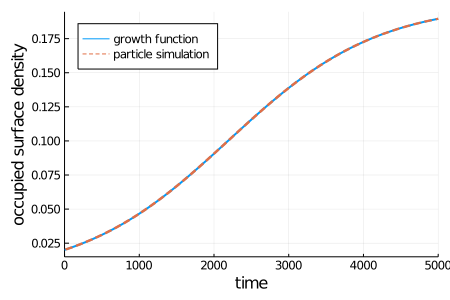

In [12]:
f1 = plot(0:(arenaParams["evolveTime"]-1-growthParams["waitTime"]), 
        volumeDens.(
            Theorist.logisticGrowth.(0:(arenaParams["evolveTime"]-growthParams["waitTime"]-1), 
            growthParams["ρ"], growthParams["k"], arenaParams["n0"]),
            arenaParams["radius"],
            arenaParams["volume"]
        ),
        label="growth function",
        linewidth=2,
        size=(450,300),
        legend=:topleft)
plot!(times_t .- growthParams["waitTime"], 
    volumeDens.(
        BParts.nCellsTime(cells_T_ID)[1:end],     
        arenaParams["radius"],
        arenaParams["volume"]
    ),
    label="particle simulation",
    linewidth=2,
    linestyle=:dash)
xlabel!("time")
ylabel!("occupied surface density")
xlims!(0,arenaParams["evolveTime"]-growthParams["waitTime"])
display(f1)

# savefig(f1, "../Figures/rho"*string(growthParams["ρ"])*"surfaceDensity_time.pdf")

Ensemble of particle simulations:

In [13]:
nSims = 100

pos_Sim = Array{Array{Union{Float64, Missing},3}}(undef, nSims)
@showprogress for i in 1:nSims
    succes = false
    while !succes 
        # try/catch construction in case boundserror occurs
        try
            @time _, posSim_t_dim_id, __, ___ = 
                BParts.randArenaEvolve(
                        arenaParams["n0"],
                        arenaParams["evolveTime"], 
                        arenaParams["timeStep"],
                        arenaParams,
                        growthParams,
                        progress=false,
                        verbose=true);
            pos_Sim[i] = posSim_t_dim_id
#             println("sim: ", i)
        catch e
#             println("fail")
            continue
        end
        succes = true
    end
end

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
215.099764 seconds (367.65 M allocations: 15.447 GiB, 7.04% gc time)


Progress:   1%|▍                                        |  ETA: 5:55:36

Building arena...
7 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
211.766620 seconds (367.39 M allocations: 15.435 GiB, 6.09% gc time)


Progress:   2%|▉                                        |  ETA: 5:49:12

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
210.264675 seconds (366.50 M allocations: 15.402 GiB, 5.57% gc time)


Progress:   3%|█▎                                       |  ETA: 5:44:02

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 7.922604422885507 found in time step0.1
anomalous collision time 5.0705894243259815 found in time step0.1
anomalous collision time 5.533838627918149 found in time step0.1
anomalous collision time 11.301491487316975 found in time step0.1
anomalous collision time 25.620415960398113 found in time step0.1
anomalous collision time 14.164107364486894 found in time step0.1
anomalous collision time 4.409980420046734 found in time step0.1
anomalous collision time 3.377318022179916 found in time step0.1
anomalous collision time 18.07373536343695 found in time step0.1
anomalous collision time 18.07373536343699 found in time step0.1
anomalous collision time 11.494606272856005 found in time step0.1
anomalous collision time 5.826541868391952 found in time step0.1
anomalous collision time 5.453480228761646 found in time step0.1
anomalous collision time 4.117

Progress:   4%|█▋                                       |  ETA: 6:30:46

207.669225 seconds (367.10 M allocations: 15.427 GiB, 4.63% gc time)
Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
225.212430 seconds (367.27 M allocations: 15.433 GiB, 8.44% gc time)


Progress:   5%|██                                       |  ETA: 6:20:44

Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
216.470155 seconds (367.86 M allocations: 15.455 GiB, 8.44% gc time)


Progress:   6%|██▌                                      |  ETA: 6:10:32

Building arena...
8 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
213.926014 seconds (367.26 M allocations: 15.430 GiB, 6.91% gc time)


Progress:   7%|██▉                                      |  ETA: 6:01:41

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 0.5903147712159533 found in time step0.1
anomalous collision time 12.807216930569743 found in time step0.1
anomalous collision time 0.5490064831865004 found in time step0.1
anomalous collision time 13.206893077542409 found in time step0.1
210.484628 seconds (367.03 M allocations: 15.427 GiB, 5.05% gc time)


Progress:   8%|███▎                                     |  ETA: 5:53:29

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 1.2086849096687022 found in time step0.1
anomalous collision time 6.242220684757239 found in time step0.1
anomalous collision time 1.2262032510628351 found in time step0.1
anomalous collision time 12.265113493750572 found in time step0.1
anomalous collision time 1.2218900100255408 found in time step0.1
anomalous collision time 0.10677020308782814 found in time step0.1
anomalous collision time 7.087138854990759 found in time step0.1
anomalous collision time 4.080871371507756 found in time step0.1
anomalous collision time 16.573030063058862 found in time step0.1
anomalous collision time 9.688958161468866 found in time step0.1
anomalous collision time 7.087138854990762 found in time step0.1
anomalous collision time 11.289724424897937 found in time step0.1
anomalous collision time 28.937274953664616 found in time step0.1
anomalous collision time 5

Progress:   9%|███▊                                     |  ETA: 5:46:11

209.935263 seconds (367.21 M allocations: 15.428 GiB, 5.83% gc time)
Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
212.753630 seconds (366.62 M allocations: 15.408 GiB, 6.33% gc time)


Progress:  10%|████▏                                    |  ETA: 5:40:06

Building arena...
1 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.147598 seconds (367.21 M allocations: 15.432 GiB, 5.12% gc time)


Progress:  11%|████▌                                    |  ETA: 5:33:43

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 4.739067633881205 found in time step0.1
anomalous collision time 3.045866057026738 found in time step0.1
anomalous collision time 13.833349321103604 found in time step0.1
anomalous collision time 3.9538707331639915 found in time step0.1
anomalous collision time 3.045866057026738 found in time step0.1
anomalous collision time 1.7901633314880359 found in time step0.1
anomalous collision time 3.116909734694202 found in time step0.1
anomalous collision time 14.710617020757946 found in time step0.1
anomalous collision time 3.045866057026738 found in time step0.1
anomalous collision time 14.710617020757955 found in time step0.1
anomalous collision time 1.0666776524324015 found in time step0.1
anomalous collision time 3.045866057026738 found in time step0.1
anomalous collision time 11.15075590621481 found in time step0.1
anomalous collision time 14.7

Progress:  12%|████▉                                    |  ETA: 5:27:49

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.913191

Progress:  13%|█████▍                                   |  ETA: 5:22:09

 seconds (367.31 M allocations: 15.430 GiB, 4.58% gc time)
Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
215.138728 seconds (367.41 M allocations: 15.438 GiB, 8.08% gc time)


Progress:  14%|█████▊                                   |  ETA: 5:17:45

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.636176 seconds (366.70 M allocations: 15.414 GiB, 4.99% gc time)


Progress:  15%|██████▏                                  |  ETA: 5:12:44

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 0.747267853201353 found in time step0.1
anomalous collision time 9.369985148234642 found in time step0.1
anomalous collision time 7.235208157268315 found in time step0.1
anomalous collision time 9.48920646176088 found in time step0.1
anomalous collision time 3.4131582555201367 found in time step0.1
anomalous collision time 7.933828496112402 found in time step0.1
anomalous collision time 9.4892064617609 found in time step0.1
anomalous collision time 7.933828496112392 found in time step0.1
anomalous collision time 8.466334262963752 found in time step0.1
anomalous collision time 9.4892064617609 found in time step0.1
anomalous collision time 7.933828496112402 found in time step0.1
anomalous collision time 9.489206461760899 found in time step0.1
anomalous collision time 10.935812283594641 found in time step0.1
anomalous collision time 25.1890398134

Progress:  16%|██████▌                                  |  ETA: 5:25:30

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.257289

Progress:  17%|███████                                  |  ETA: 5:19:34

 seconds (367.55 M allocations: 15.451 GiB, 4.70% gc time)
Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
214.799944 seconds (367.56 M allocations: 15.452 GiB, 7.91% gc time)


Progress:  18%|███████▍                                 |  ETA: 5:14:30

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 0.26949809889326914 found in time step0.1
anomalous collision time 2.0899741621274224 found in time step0.1
anomalous collision time 8.420270247028906 found in time step0.1
anomalous collision time 9.145689828509498 found in time step0.1
anomalous collision time 8.420270247028906 found in time step0.1
anomalous collision time 5.451035116516415 found in time step0.1
anomalous collision time 4.834477507095618 found in time step0.1
anomalous collision time 15.280364238027373 found in time step0.1
anomalous collision time 6.584282028405785 found in time step0.1
anomalous collision time 15.280364238027381 found in time step0.1
anomalous collision time 4.413058332832228 found in time step0.1
anomalous collision time 15.280364238027376 found in time step0.1
anomalous collision time 12.081378693743984 found in time step0.1
anomalous collision time 15.

Progress:  19%|███████▊                                 |  ETA: 5:09:00

 seconds (367.01 M allocations: 15.424 GiB, 4.79% gc time)
Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.623803 seconds (367.30 M allocations: 15.433 GiB, 4.91% gc time)


Progress:  20%|████████▎                                |  ETA: 5:03:39

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.569306 seconds (367.58 M allocations: 15.443 GiB, 4.86% gc time)


Progress:  21%|████████▋                                |  ETA: 4:58:33

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.746241

Progress:  22%|█████████                                |  ETA: 4:53:39

 seconds (367.31 M allocations: 15.430 GiB, 5.42% gc time)
Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.133476 seconds (367.38 M allocations: 15.438 GiB, 4.85% gc time)


Progress:  23%|█████████▍                               |  ETA: 4:48:47

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
208.046809 seconds (366.84 M allocations: 15.412 GiB, 5.34% gc time)


Progress:  24%|█████████▉                               |  ETA: 4:44:09

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.889722

Progress:  25%|██████████▎                              |  ETA: 4:39:36

 seconds (367.11 M allocations: 15.428 GiB, 5.40% gc time)
Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.878492 seconds (367.09 M allocations: 15.419 GiB, 4.74% gc time)


Progress:  26%|██████████▋                              |  ETA: 4:35:02

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.922894

Progress:  27%|███████████▏                             |  ETA: 4:30:33

 seconds (367.41 M allocations: 15.433 GiB, 4.74% gc time)
Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 0.1048760732412776 found in time step0.1
anomalous collision time 10.991251257660135 found in time step0.1
anomalous collision time 4.807640924036425 found in time step0.1
anomalous collision time 6.421109636645432 found in time step0.1
anomalous collision time 17.321532021867483 found in time step0.1
anomalous collision time 7.053332478752535 found in time step0.1
anomalous collision time 18.038891762309614 found in time step0.1
anomalous collision time 22.17790697470494 found in time step0.1
208.578949 seconds (366.93 M allocations: 15.423 GiB, 5.52% gc time)


Progress:  28%|███████████▌                             |  ETA: 4:26:16

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.564539 seconds (367.03 M allocations: 15.421 GiB, 4.96% gc time)


Progress:  29%|███████████▉                             |  ETA: 4:21:54

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
209.203879 seconds (367.51 M allocations: 15.440 GiB, 5.39% gc time)


Progress:  30%|████████████▎                            |  ETA: 4:17:45

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 0.155306277589694 found in time step0.1
anomalous collision time 22.499109479479564 found in time step0.1
anomalous collision time 9.351305755056536 found in time step0.1
anomalous collision time 4.743300185404669 found in time step0.1
anomalous collision time 4.515831485356327 found in time step0.1
anomalous collision time 22.499109479479966 found in time step0.1
anomalous collision time 10.054432171888145 found in time step0.1
anomalous collision time 9.950051729219846 found in time step0.1
anomalous collision time 0.8106805260641131 found in time step0.1
anomalous collision time 10.495381279243624 found in time step0.1
anomalous collision time 11.763827783122085 found in time step0.1
anomalous collision time 12.145329145623178 found in time step0.1
anomalous collision time 403.5478912265138 found in time step0.1
anomalous collision time 9.1

Progress:  31%|████████████▊                            |  ETA: 4:16:05

Building arena...
1 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
214.734895 seconds (367.40 M allocations: 15.438 GiB, 7.38% gc time)


Progress:  32%|█████████████▏                           |  ETA: 4:12:06

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.640283 seconds (366.57 M allocations: 15.399 GiB, 4.70% gc time)


Progress:  33%|█████████████▌                           |  ETA: 4:07:50

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.450622 seconds (367.30 M allocations: 15.434 GiB, 4.87% gc time)


Progress:  34%|██████████████                           |  ETA: 4:03:36

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
208.088153 seconds (366.77 M allocations: 15.414 GiB, 6.20% gc time)


Progress:  35%|██████████████▍                          |  ETA: 3:59:30

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.151431 seconds (366.82 M allocations: 15.406 GiB, 5.27% gc time)


Progress:  36%|██████████████▊                          |  ETA: 3:55:23

Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.859908 seconds (367.10 M allocations: 15.427 GiB, 4.60% gc time)


Progress:  37%|███████████████▏                         |  ETA: 3:51:16

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.496884 seconds (366.81 M allocations: 15.417 GiB, 4.22% gc time)


Progress:  38%|███████████████▋                         |  ETA: 3:50:10

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 0.3876570053475068 found in time step0.1
anomalous collision time 1.91697325247775 found in time step0.1
anomalous collision time 7.603508795660055 found in time step0.1
anomalous collision time 19.337159922824636 found in time step0.1
anomalous collision time 7.64610806271894 found in time step0.1
anomalous collision time 29.14235315324008 found in time step0.1
anomalous collision time 6.966945230509157 found in time step0.1
anomalous collision time 7.782227258016817 found in time step0.1
anomalous collision time 29.14235315324015 found in time step0.1
anomalous collision time 7.260149788111248 found in time step0.1
anomalous collision time 1.3471733449143868 found in time step0.1
anomalous collision time 6.49062606248488 found in time step0.1
anomalous collision time 34.873527280208585 found in time step0.1
anomalous collision time 6.4906260

Progress:  39%|████████████████                         |  ETA: 3:50:55

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
208.395369 seconds (367.15 M allocations: 15.426 GiB, 4.90% gc time)


Progress:  40%|████████████████▍                        |  ETA: 3:46:40

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.428266

Progress:  41%|████████████████▊                        |  ETA: 3:42:26

 seconds (366.72 M allocations: 15.411 GiB, 5.72% gc time)
Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.122086 seconds (366.79 M allocations: 15.414 GiB, 5.37% gc time)


Progress:  42%|█████████████████▎                       |  ETA: 3:38:14

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
209.730444 seconds (366.73 M allocations: 15.406 GiB, 6.66% gc time)


Progress:  43%|█████████████████▋                       |  ETA: 3:34:07

Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.041820 seconds (367.50 M allocations: 15.446 GiB, 5.11% gc time)


Progress:  44%|██████████████████                       |  ETA: 3:29:57

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.203126 seconds (367.01 M allocations: 15.418 GiB, 4.48% gc time)


Progress:  45%|██████████████████▌                      |  ETA: 3:25:47

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.901356 seconds (367.17 M allocations: 15.425 GiB, 4.86% gc time)


Progress:  46%|██████████████████▉                      |  ETA: 3:21:42

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.583453 seconds (366.90 M allocations: 15.421 GiB, 4.74% gc time)


Progress:  47%|███████████████████▎                     |  ETA: 3:17:36

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 10.418713683092975 found in time step0.1
anomalous collision time 2.0680179015365834 found in time step0.1
anomalous collision time 4.734004703901103 found in time step0.1
anomalous collision time 5.533505219648398 found in time step0.1
anomalous collision time 5.537885228089933 found in time step0.1
anomalous collision time 2.8920401997531924 found in time step0.1
anomalous collision time 5.0904887369937715 found in time step0.1
anomalous collision time 6.153557968228139 found in time step0.1
anomalous collision time 4.265189125750214 found in time step0.1
anomalous collision time 10.625610409007791 found in time step0.1
anomalous collision time 3.6136001378183336 found in time step0.1
anomalous collision time 2.9470106249877834 found in time step0.1
210.050856 seconds (367.14 M allocations: 15.430 GiB, 5.60% gc time)


Progress:  48%|███████████████████▋                     |  ETA: 3:13:38

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.035605 seconds (367.66 M allocations: 15.449 GiB, 4.84% gc time)


Progress:  49%|████████████████████▏                    |  ETA: 3:09:38

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.223817 seconds (366.99 M allocations: 15.423 GiB, 5.72% gc time)


Progress:  50%|████████████████████▌                    |  ETA: 3:05:39

Building arena...
7 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 14.649843538800091 found in time step0.1
anomalous collision time 4.660451842652414 found in time step0.1
anomalous collision time 3.9832161322116866 found in time step0.1
anomalous collision time 18.199256722500383 found in time step0.1
anomalous collision time 21.50729200308364 found in time step0.1
anomalous collision time 14.674531077862593 found in time step0.1
anomalous collision time 21.507292003083638 found in time step0.1
anomalous collision time 2.0860963563021615 found in time step0.1
anomalous collision time 4.7798074707015 found in time step0.1
anomalous collision time 1.5692639942750612 found in time step0.1
anomalous collision time 21.50729200308367 found in time step0.1
anomalous collision time 3.2971218787236984 found in time step0.1
anomalous collision time 21.507292003083624 found in time step0.1
anomalous collision time 7.5

Progress:  51%|████████████████████▉                    |  ETA: 3:04:25

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.470151

Progress:  52%|█████████████████████▍                   |  ETA: 3:00:20

 seconds (367.11 M allocations: 15.430 GiB, 5.12% gc time)
Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.777122 seconds (367.13 M allocations: 15.425 GiB, 5.07% gc time)


Progress:  53%|█████████████████████▊                   |  ETA: 2:56:18

Building arena...
0 overlaps found.
::::: Initial total kinetic energy: 0.01999999999999999
208.436284 seconds (366.97 M allocations: 15.426 GiB, 5.62% gc time)


Progress:  54%|██████████████████████▏                  |  ETA: 2:52:20

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.311759 seconds (366.66 M allocations: 15.406 GiB, 5.78% gc time)


Progress:  55%|██████████████████████▌                  |  ETA: 2:48:21

Building arena...
7 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.405606 seconds (367.64 M allocations: 15.443 GiB, 4.79% gc time)


Progress:  56%|███████████████████████                  |  ETA: 2:44:21

Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.345142 seconds (367.28 M allocations: 15.426 GiB, 4.61% gc time)


Progress:  57%|███████████████████████▍                 |  ETA: 2:40:23

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
212.387153 seconds (367.79 M allocations: 15.448 GiB, 7.58% gc time)


Progress:  58%|███████████████████████▊                 |  ETA: 2:36:31

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.201995 seconds (367.57 M allocations: 15.443 GiB, 4.55% gc time)


Progress:  59%|████████████████████████▎                |  ETA: 2:32:35

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
220.091803 seconds (367.43 M allocations: 15.439 GiB, 8.19% gc time)


Progress:  60%|████████████████████████▋                |  ETA: 2:28:50

Building arena...
7 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.169555 seconds (366.99 M allocations: 15.423 GiB, 4.46% gc time)


Progress:  61%|█████████████████████████                |  ETA: 2:24:54

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.034461 seconds (367.58 M allocations: 15.445 GiB, 4.65% gc time)


Progress:  62%|█████████████████████████▍               |  ETA: 2:21:01

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.154066

Progress:  63%|█████████████████████████▉               |  ETA: 2:17:07

 seconds (366.88 M allocations: 15.422 GiB, 4.63% gc time)
Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.785876

Progress:  64%|██████████████████████████▎              |  ETA: 2:13:16

 seconds (366.96 M allocations: 15.428 GiB, 4.59% gc time)
Building arena...
1 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.189357 seconds (367.13 M allocations: 15.423 GiB, 4.72% gc time)


Progress:  65%|██████████████████████████▋              |  ETA: 2:09:24

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 0.10736728595249584 found in time step0.1
anomalous collision time 1.1219431992505207 found in time step0.1
anomalous collision time 7.097977111008356 found in time step0.1
anomalous collision time 2.456384058622421 found in time step0.1
anomalous collision time 7.13723490600816 found in time step0.1
anomalous collision time 8.105802234145173 found in time step0.1
anomalous collision time 14.867855361518187 found in time step0.1
anomalous collision time 6.950725147670542 found in time step0.1
anomalous collision time 11.404897325379507 found in time step0.1
anomalous collision time 43.51882338254748 found in time step0.1
anomalous collision time 9.833917061055073 found in time step0.1
anomalous collision time 4.400704971691315 found in time step0.1
anomalous collision time 1.5971668032472297 found in time step0.1
anomalous collision time 6.983

Progress:  66%|███████████████████████████              |  ETA: 2:07:07

203.811677 seconds (366.75 M allocations: 15.419 GiB, 4.34% gc time)
Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
210.358879 seconds (367.26 M allocations: 15.428 GiB, 6.28% gc time)


Progress:  67%|███████████████████████████▌             |  ETA: 2:03:16

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.559645 seconds (367.09 M allocations: 15.422 GiB, 4.74% gc time)


Progress:  68%|███████████████████████████▉             |  ETA: 1:59:23

Building arena...
1 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.876258

Progress:  69%|████████████████████████████▎            |  ETA: 1:55:31

 seconds (367.43 M allocations: 15.441 GiB, 5.94% gc time)
Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
210.955993

Progress:  70%|████████████████████████████▊            |  ETA: 1:51:42

 seconds (367.08 M allocations: 15.427 GiB, 6.17% gc time)
Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.629182 seconds (367.16 M allocations: 15.431 GiB, 4.86% gc time)


Progress:  71%|█████████████████████████████▏           |  ETA: 1:47:52

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.069067 seconds (366.83 M allocations: 15.416 GiB, 4.80% gc time)


Progress:  72%|█████████████████████████████▌           |  ETA: 1:44:02

Building arena...
7 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.963542 seconds (367.15 M allocations: 15.429 GiB, 4.83% gc time)


Progress:  73%|█████████████████████████████▉           |  ETA: 1:40:12

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.330760 seconds (367.62 M allocations: 15.443 GiB, 4.68% gc time)


Progress:  74%|██████████████████████████████▍          |  ETA: 1:36:24

Building arena...
1 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.347435 seconds (367.34 M allocations: 15.435 GiB, 4.90% gc time)


Progress:  75%|██████████████████████████████▊          |  ETA: 1:32:36

Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.724515

Progress:  76%|███████████████████████████████▏         |  ETA: 1:28:48

 seconds (367.35 M allocations: 15.435 GiB, 4.53% gc time)
Building arena...
0 overlaps found.
::::: Initial total kinetic energy: 0.01999999999999999
209.229823

Progress:  77%|███████████████████████████████▋         |  ETA: 1:25:02

 seconds (367.30 M allocations: 15.423 GiB, 5.83% gc time)
Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
203.956272

Progress:  78%|████████████████████████████████         |  ETA: 1:21:15

 seconds (367.10 M allocations: 15.426 GiB, 4.49% gc time)
Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.915208 seconds (366.98 M allocations: 15.419 GiB, 4.62% gc time)


Progress:  79%|████████████████████████████████▍        |  ETA: 1:17:29

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
206.233012 seconds (367.63 M allocations: 15.448 GiB, 5.09% gc time)


Progress:  80%|████████████████████████████████▊        |  ETA: 1:13:44

Building arena...
1 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.628803 seconds (367.45 M allocations: 15.441 GiB, 4.56% gc time)


Progress:  81%|█████████████████████████████████▎       |  ETA: 1:09:59

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
208.652169

Progress:  82%|█████████████████████████████████▋       |  ETA: 1:06:15

 seconds (367.40 M allocations: 15.438 GiB, 6.14% gc time)
Building arena...
7 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
203.991535 seconds (366.86 M allocations: 15.421 GiB, 4.48% gc time)


Progress:  83%|██████████████████████████████████       |  ETA: 1:02:31

Building arena...
1 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.413876

Progress:  84%|██████████████████████████████████▌      |  ETA: 0:58:47

 seconds (367.57 M allocations: 15.443 GiB, 4.55% gc time)
Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.971610 seconds (367.43 M allocations: 15.439 GiB, 4.74% gc time)


Progress:  85%|██████████████████████████████████▉      |  ETA: 0:55:04

Building arena...
0 overlaps found.
::::: Initial total kinetic energy: 0.01999999999999999
203.803311 seconds (366.88 M allocations: 15.420 GiB, 4.53% gc time)


Progress:  86%|███████████████████████████████████▎     |  ETA: 0:51:21

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
203.915505 seconds (367.22 M allocations: 15.432 GiB, 4.49% gc time)


Progress:  87%|███████████████████████████████████▋     |  ETA: 0:47:39

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
209.370528

Progress:  88%|████████████████████████████████████▏    |  ETA: 0:43:57

 seconds (367.35 M allocations: 15.437 GiB, 6.06% gc time)
Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.096728

Progress:  89%|████████████████████████████████████▌    |  ETA: 0:40:16

 seconds (367.16 M allocations: 15.419 GiB, 4.48% gc time)
Building arena...
9 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
anomalous collision time 4.043245394091664 found in time step0.1
anomalous collision time 5.40205123683683 found in time step0.1
anomalous collision time 4.05370940407049 found in time step0.1
anomalous collision time 6.150363496269028 found in time step0.1
anomalous collision time 6.25230892241129 found in time step0.1


Progress:  90%|████████████████████████████████████▉    |  ETA: 0:36:34

204.027604 seconds (367.42 M allocations: 15.434 GiB, 4.62% gc time)
Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.506932

Progress:  91%|█████████████████████████████████████▎   |  ETA: 0:32:54

 seconds (367.67 M allocations: 15.447 GiB, 4.60% gc time)
Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
203.810658 seconds (366.61 M allocations: 15.409 GiB, 4.61% gc time)


Progress:  92%|█████████████████████████████████████▊   |  ETA: 0:29:13

Building arena...
7 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.345081 seconds (367.39 M allocations: 15.435 GiB, 4.71% gc time)


Progress:  93%|██████████████████████████████████████▏  |  ETA: 0:25:33

Building arena...
3 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.769576 seconds (367.61 M allocations: 15.440 GiB, 4.47% gc time)


Progress:  94%|██████████████████████████████████████▌  |  ETA: 0:21:53

Building arena...
5 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.669922

Progress:  95%|███████████████████████████████████████  |  ETA: 0:18:14

 seconds (366.98 M allocations: 15.426 GiB, 6.22% gc time)
Building arena...
6 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
210.642392 seconds (367.37 M allocations: 15.434 GiB, 5.91% gc time)


Progress:  96%|███████████████████████████████████████▍ |  ETA: 0:14:34

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
205.654939 seconds (367.05 M allocations: 15.428 GiB, 4.86% gc time)


Progress:  97%|███████████████████████████████████████▊ |  ETA: 0:10:55

Building arena...
4 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
204.092871 seconds (367.75 M allocations: 15.445 GiB, 4.47% gc time)


Progress:  98%|████████████████████████████████████████▏|  ETA: 0:07:17

Building arena...
2 overlaps found.
Arena with 100 cells built.
::::: Initial total kinetic energy: 0.01999999999999999
207.710975 seconds (366.86 M allocations: 15.419 GiB, 6.00% gc time)


Progress:  99%|████████████████████████████████████████▋|  ETA: 0:03:38

Building arena...
0 overlaps found.
::::: Initial total kinetic energy: 0.01999999999999999
210.336144 seconds (367.12 M allocations: 15.423 GiB, 6.15% gc time)


Progress: 100%|█████████████████████████████████████████| Time: 6:03:36


### Mean squared displacement

In [14]:
msdTimes = (growthParams["waitTime"]+1, arenaParams["evolveTime"])

(501, 5500)

In [15]:
@time msd_Sim_t = (p_t_dim_id -> BParts.meanSquaredDisplacement(p_t_dim_id, msdTimes)).(pos_Sim);
msdPart_t = Array{Float64, 1}(undef, msdTimes[2]-msdTimes[1]+1)
for i in 1:(msdTimes[2]-msdTimes[1]+1)
    msdPart_t[i] = mean([ msd_tt[i] for msd_tt in msd_Sim_t ])
end

182.552987 seconds (948.20 M allocations: 106.101 GiB, 17.98% gc time)


In [16]:
length(msd_Sim_t[1])

5000

In [17]:
timesMSD_t, msdLan_t = 
    Theorist.msd(
        langevinEnsemble, 
        arenaParams,
        (growthParams["waitTime"]+1, arenaParams["evolveTime"])
    )

(501:1:5500, [0.0, 0.00041802467917589415, 0.0016659689697792488, 0.003740282585017833, 0.00663469217284989, 0.01033859479738095, 0.014844190034555007, 0.020140019604011336, 0.02622194611354581, 0.03310276253711872  …  131.25513912649336, 131.2721466934292, 131.28948363088568, 131.3058155738542, 131.32144243818223, 131.33875076175676, 131.35709047302555, 131.37627860542312, 131.3952192570767, 131.413724569903])

In [18]:
saveName = "growingPop_multSims_rho"*string(growthParams["ρ"])*".jld2"

@save saveName arenaParams growthParams msd_Sim_t msdPart_t msdLan_t

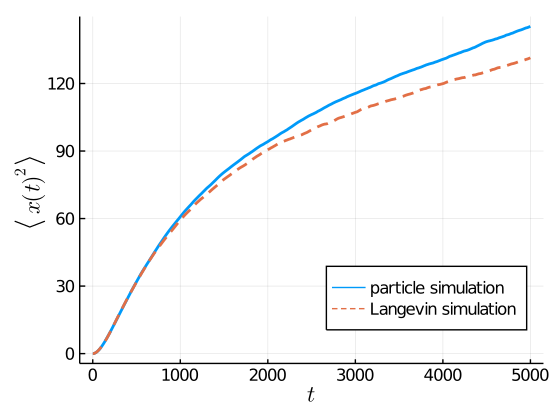

In [19]:
p2 = plot(1:msdTimes[2]-msdTimes[1], msdPart_t[2:end], label="particle simulation", legend=:bottomright, linewidth=2,
    size=(400,300), 
    dpi=140)
plot!(1:msdTimes[2]-msdTimes[1], msdLan_t[2:end], label="Langevin simulation", linestyle=:dash, linewidth=2)
xlabel!(L"t")
ylabel!(L"\left\langle x(t)^2 \right\rangle")
# title!(latexstring("\\rho="*string(growthParams["ρ"])))
display(p2)

# savefig(p2, "../Figures/rho"*string(growthParams["ρ"])*"msd_time.png")
savefig(p2, "../Figures/rho"*string(growthParams["ρ"])*"msd_time.pdf")

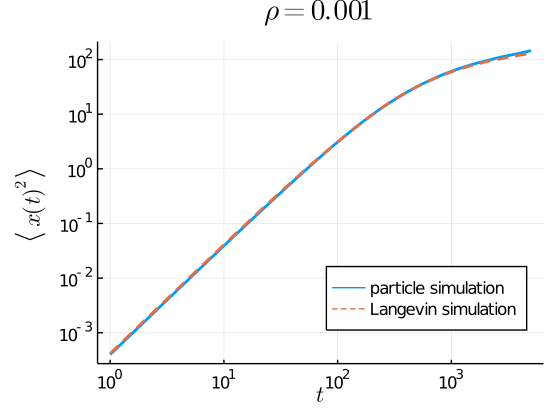

In [20]:
p2 = plot(1:msdTimes[2]-msdTimes[1], msdPart_t[2:end], label="particle simulation", legend=:bottomright, linewidth=2,
    xaxis=:log10, yaxis=:log10,
    size=(400,300), 
    dpi=140)
plot!(1:msdTimes[2]-msdTimes[1], msdLan_t[2:end], label="Langevin simulation", linestyle=:dash, linewidth=2)
xlabel!(L"t")
ylabel!(L"\left\langle x(t)^2 \right\rangle")
title!(latexstring("\\rho="*string(growthParams["ρ"])))
display(p2)

# savefig(p2, "../Figures/rho"*string(growthParams["ρ"])*"msdLoglog_time.png")
# savefig(p2, "../Figures/rho"*string(growthParams["ρ"])*"msdLoglog_time.pdf")

## MSD linear regime

In [21]:
# msdTimes = (arenaParams["evolveTime"]-1000, arenaParams["evolveTime"])

In [22]:
# @time msd_Sim_t = (p_t_dim_id -> BParts.meanSquaredDisplacement(p_t_dim_id, msdTimes)).(pos_Sim);
# msdPart_t = Array{Float64, 1}(undef, msdTimes[2]-msdTimes[1]+1)
# for i in 1:(msdTimes[2]-msdTimes[1]+1)
#     msdPart_t[i] = mean([ msd_tt[i] for msd_tt in msd_Sim_t ])
# end

In [23]:
# length(msd_Sim_t[1])

In [24]:
# @time timesMSD_t, msdLan_t = 
#     Theorist.msd(
#         langevinEnsemble, 
#         arenaParams,
#         (arenaParams["evolveTime"]-1000, arenaParams["evolveTime"])
#     )
# # msdPar_t = BParts.meanSquaredDisplacement(pos_t_dim_id[1:msdTime,:,:], arenaParams["bperiod"]);

In [25]:
# p2 = plot(1:msdTimes[2]-msdTimes[1], msdPart_t[2:end], label="particle simulation", legend=:bottomright, linewidth=2,
#     size=(400,300), 
#     dpi=140)
# plot!(1:msdTimes[2]-msdTimes[1], msdLan_t[2:end], label="Langevin simulation", linestyle=:dash, linewidth=2)
# xlabel!(L"t")
# ylabel!(L"\left\langle x(t)^2 \right\rangle")
# # title!(latexstring("\\rho="*string(growthParams["ρ"])))
# display(p2)


In [26]:
# msdSingles_Sim = []

# for sim in 1:nSims
#     msd_t = BParts.meanSquaredDisplacement(pos_Sim[sim], msdTimes)
#     push!(msdSingles_Sim, msd_t)
# end

In [27]:
# p3 = plot(1:msdTimes[2]-msdTimes[1], msdLan_t[2:end], label="Langevin simulation", linestyle=:dash, linewidth=3,
#     legend=:topleft,
#     size=(500,300),
#     dpi=140)
# # plot!(1:msdTimes[2]-msdTimes[1], msdPart_t[2:end], label="particle simulation average", linestyle=:dashdot, linewidth=3)
# # plot!(1:msdTimes[2]-msdTimes[1], msdPart0_t[2:end])
# for s in 1:nSims
#     plot!(1:msdTimes[2]-msdTimes[1], msdSingles_Sim[s][2:end],
# #         label="particle simulation "*string(s),
#         label="")
# end
# xlabel!(L"t")
# ylabel!(L"\left\langle x(t)^2 \right\rangle")
# # title!(latexstring("\\rho="*string(growthParams["ρ"])))
# display(p3)

# # savefig(p2, "../Figures/rho"*string(growthParams["ρ"])*"msd_time.png")
# savefig(p3, "../Figures/rho"*string(growthParams["ρ"])*"msdSingles_time.pdf")

## Position monitor

In [28]:
# pos_Sim[i] = posSim_t_dim_id
# cellID = 22

# p3 = plot(pos_Sim[4][:,1,1],pos_Sim[4][:,2,1], label="")
# for cellID in 2:100
#     plot!(pos_Sim[4][:,1,cellID],pos_Sim[4][:,2,cellID], label="")
# end

# display(p3)

In [29]:
# simNumber = 3

# p3 = plot(pos_Sim[simNumber][:,1,1],pos_Sim[simNumber][:,2,1],
# #     dpi=300,
#     label="")
# for cellID in 2:50
#     plot!(pos_Sim[simNumber][:,1,cellID],pos_Sim[simNumber][:,2,cellID], label="")
# end

# display(p3)

# # savefig(p3, "singleTrajectories_Sim"*string(simNumber)*".png")

In [30]:
# simNumber = 4

# p3 = plot(pos_Sim[simNumber][:,1,1],pos_Sim[simNumber][:,2,1],
# #     dpi=300,
#     label="")
# for cellID in 2:50
#     plot!(pos_Sim[simNumber][:,1,cellID],pos_Sim[simNumber][:,2,cellID], label="")
# end

# display(p3)

# # savefig(p3, "singleTrajectories_Sim"*string(simNumber)*".png")

In [31]:
# simNumber = 1

# p3 = plot(pos_Sim[simNumber][:,1,1],pos_Sim[simNumber][:,2,1],
# #     dpi=300,
#     label="")
# for cellID in 2:50
#     plot!(pos_Sim[simNumber][:,1,cellID],pos_Sim[simNumber][:,2,cellID], label="")
# end

# display(p3)

# # savefig(p3, "singleTrajectories_Sim"*string(simNumber)*".png")

In [32]:
# simNumber = 2

# p3 = plot(pos_Sim[simNumber][:,1,1],pos_Sim[simNumber][:,2,1],
# #     dpi=300,
#     label="")
# for cellID in 2:50
#     plot!(pos_Sim[simNumber][:,1,cellID],pos_Sim[simNumber][:,2,cellID], label="")
# end

# display(p3)

# # savefig(p3, "singleTrajectories_Sim"*string(simNumber)*".png")

In [33]:
# simNumber = 5

# p3 = plot(pos_Sim[simNumber][:,1,1],pos_Sim[simNumber][:,2,1],
# #     dpi=300,
#     label="")
# for cellID in 2:50
#     plot!(pos_Sim[simNumber][:,1,cellID],pos_Sim[simNumber][:,2,cellID], label="")
# end

# display(p3)

# # savefig(p3, "singleTrajectories_Sim"*string(simNumber)*".png")

## Single trajectories

In [34]:
msdSingles_Sim = []

for sim in 1:nSims
    msd_t = BParts.meanSquaredDisplacement(pos_Sim[sim], msdTimes)
    push!(msdSingles_Sim, msd_t)
end

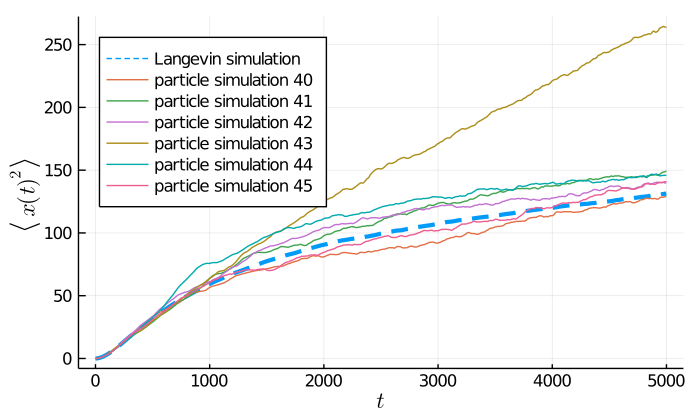

In [67]:
p2 = plot(1:msdTimes[2]-msdTimes[1], msdLan_t[2:end], label="Langevin simulation", linestyle=:dash, linewidth=3,
    legend=:topleft,
    size=(500,300),
    dpi=140)
# plot!(1:msdTimes[2]-msdTimes[1], msdPart_t[2:end], label="particle simulation average", linestyle=:dashdot, linewidth=3)
# plot!(1:msdTimes[2]-msdTimes[1], msdPart0_t[2:end])
sIn = 40

for s in sIn:sIn+5
    plot!(1:msdTimes[2]-msdTimes[1], msdSingles_Sim[s][2:end],
        label="particle simulation "*string(s)
#         label=""
    )
end
xlabel!(L"t")
ylabel!(L"\left\langle x(t)^2 \right\rangle")
# title!(latexstring("\\rho="*string(growthParams["ρ"])))
display(p2)

# savefig(p2, "../Figures/rho"*string(growthParams["ρ"])*"msd_time.png")
savefig(p2, "../Figures/rho"*string(growthParams["ρ"])*"msdSingles_time.pdf")

In [71]:
simNumber = 43

p3 = plot(pos_Sim[simNumber][:,1,1],pos_Sim[simNumber][:,2,1],
#     dpi=300,
    label="")
for cellID in 2:100
    plot!(pos_Sim[simNumber][:,1,cellID],pos_Sim[simNumber][:,2,cellID], label="")
end

display(p3)

# savefig(p3, "singleTrajectories_Sim"*string(simNumber)*".png")

In [72]:
simNumber = 44

p3 = plot(pos_Sim[simNumber][:,1,1],pos_Sim[simNumber][:,2,1],
#     dpi=300,
    label="")
for cellID in 2:100
    plot!(pos_Sim[simNumber][:,1,cellID],pos_Sim[simNumber][:,2,cellID], label="")
end

display(p3)

# savefig(p3, "singleTrajectories_Sim"*string(simNumber)*".png")